# Análisis y Preprocesamiento

Este Jupyter Notebook contiene los datos del análisis inicial para el dataframe winemag con 130K entradas sobre vinos y calificaciones.

Primero se realizará importará Pandas, Numpy, Matplotlib y Seaborn, para comenzar el análisis respectivo sobre el dataframe.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

pd.set_option('display.max_rows', None)

In [2]:
df = pd.read_csv("winemag-data-130k-v2.csv")

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 129971 entries, 0 to 129970
Data columns (total 14 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   Unnamed: 0             129971 non-null  int64  
 1   country                129908 non-null  object 
 2   description            129971 non-null  object 
 3   designation            92506 non-null   object 
 4   points                 129971 non-null  int64  
 5   price                  120975 non-null  float64
 6   province               129908 non-null  object 
 7   region_1               108724 non-null  object 
 8   region_2               50511 non-null   object 
 9   taster_name            103727 non-null  object 
 10  taster_twitter_handle  98758 non-null   object 
 11  title                  129971 non-null  object 
 12  variety                129970 non-null  object 
 13  winery                 129971 non-null  object 
dtypes: float64(1), int64(2), object(11)


In [4]:
df.head(2)

,Unnamed: 0,country,description,designation,points,price,province,region_1,region_2,taster_name,taster_twitter_handle,title,variety,winery
0,0,Italy,"Aromas include tropical fruit, broom, brimston...",Vulkà Bianco,87,NaN,Sicily & Sardinia,Etna,NaN,Kerin O’Keefe,@kerinokeefe,Nicosia 2013 Vulkà Bianco (Etna),White Blend,Nicosia
1,1,Portugal,"This is ripe and fruity, a wine that is smooth...",Avidagos,87,15.0,Douro,NaN,NaN,Roger Voss,@vossroger,Quinta dos Avidagos 2011 Avidagos Red (Douro),Portuguese Red,Quinta dos Avidagos


Con esto encontramos las columnas:
* country → Identificando al país donde se elaboró el vino
* description → Descripción del vino, con sus sabores
* designation → Es el tipo de vino, diferente al tipo de uva
* Points → Es el puntaje que le dió el catador del vino
* Price → El costo del vino en dolares
* Province / region_1 / region_2 → Es la provincia y región donde el vino fué cosechado
* taster_name / taster_twitter_handle→ El nombre del catador y su twitter
* title → El nombre del vino
* variety → El varietal (uva) del vino
* winery → Es la casa que preparó el vino

Así mismo encontramos que existen varios valores nulos, en su mayoría en region_2, twitter, designation. Se analizará mas adelante que se hará en cada respectivo caso.

En total se tienen 129971 entradas (filas), con 13 columnas, donde la mayoría son tipo objeto, excepto el puntaje que es un valor entero y el precio que es un número flotante.

Realizando el análisis de las variables cuantitativas, se encuentra para puntos y precios:

In [5]:
df.describe()

,Unnamed: 0,points,price
count,129971.000000,129971.000000,120975.000000
mean,64985.000000,88.447138,35.363389
std,37519.540256,3.039730,41.022218
min,0.000000,80.000000,4.000000
25%,32492.500000,86.000000,17.000000
50%,64985.000000,88.000000,25.000000
75%,97477.500000,91.000000,42.000000
max,129970.000000,100.000000,3300.000000


Esto muestra que el rango de precios varía entre 4USD y 3300 USD con un promedio de 35 USD. Vemos que los percetiles hasta 75% se encuentran con valores de 42 USD, por lo que se encuentra que la mayoría de vinos tienen un precio que no es exorbitante pero se hará un análisis en detalle de percentiles más adelante. Así mismo, encontramos el mismo percentil para el puntaje, por lo que vemos que la mayoría de vinos no tiene un porcentaje tan alto, esto se deduce por que los valores de puntaje van de 80 a 100, por lo que podría hacerse una normalización de dichos datos.

Por los valores iniciales, no parece indicar que se tenga un valor atípico. (Aunque el valor de 3300 USD podría llegar a ser uno de ellos).

Para las variables cualitativas, tenemos los siguientes datos:

In [6]:
df.describe(include = ['O'])

,country,description,designation,province,region_1,region_2,taster_name,taster_twitter_handle,title,variety,winery
count,129908,129971,92506,129908,108724,50511,103727,98758,129971,129970,129971
unique,43,119955,37979,425,1229,17,19,15,118840,707,16757
top,US,"Seductively tart in lemon pith, cranberry and ...",Reserve,California,Napa Valley,Central Coast,Roger Voss,@vossroger,Gloria Ferrer NV Sonoma Brut Sparkling (Sonoma...,Pinot Noir,Wines & Winemakers
freq,54504,3,2009,36247,4480,11065,25514,25514,11,13272,222


In [7]:
total = df['country'].count()
count_designation = df['designation'].count()
count_region_1 = df['region_1'].count()
count_region_2 = df['region_2'].count()
count_taster_name = df['taster_name'].count()
count_taster_twitter_handle = df['taster_twitter_handle'].count()

print("The Description Null Percent is" , 1 - (count_designation/total)*100 , "%")
print("The Region_1 Null Percent is" , 1 - (count_region_1/total)*100 , "%")
print("The Region_2 Null Percent is" , 1 - (count_region_2/total)*100 , "%")
print("The Taster Null Percent is" , 1 - (count_taster_name/total)*100 , "%")
print("The Twitter Null Percent is" , 1 - (count_taster_twitter_handle/total)*100 , "%")


The Description Null Percent is -70.20885549773686 %
The Region_1 Null Percent is -82.69307509930104 %
The Region_2 Null Percent is -37.88213197031746 %
The Taster Null Percent is -78.84650675862919 %
The Twitter Null Percent is -75.02149213289405 %


* Country: Tenemos 43 países para el análisis general donde 54504 entradas correspondend a Estados Unidos.
* Description: Casi todos los valores son únicos, donde encontramos solo un conteo de tres para el mismo tipo. Por ser casi un valor único por cada serie de datos, es posible que sea un valor que no represente un dato útil en el análisis
* Designation: Existen 37979 valores de la designación, sin embargo se encuentra hasta 2009 series con este dato, sin embargo se encuentra que un 28,8% de estos datos son nulos.
* Province: Existen 425 provincias, las cuales van a ser un dato bastante interesante para analizar. Es interesante ver la correlación de la provincia con la designación y varietal. Así mismo, se debe realizar un análisis de correlación entre la provincia y la casa productora del vino.
* region_1: Cuenta con 1229 valores únicos, donde 4480 son en Napa Valley, un área interesante para analizar sobre la producción de vinos y las casas productoras de vino, sin embargo, tiene 16,3% de valores nulos. Es un buen datos complementario para la provincia.
* region_2: Tiene 17 valores únicos y 61,1% de valores núlos, por lo que es posible que no represente un dato muy util en el análisis geogrñafico.
* taster_name: Se tienen 19 catadores de vinos en total. Sería interesante analizar la correlación de los catadores tanto con la región, el precio, pero en especial con el varietal y la casa productora, para ver si hay cierta inclinación que favorezca ciertos vinos/casas. Tiene un porcentaje de valores nulos del 20%, por lo cual también es interesante ver si hay una relación de estos puntajes con algún tipo de vino o casa productora.
* taster_twitter: Solo hay 15 valores únicos con un porcentaje de valores nulos del 24%. Se puede analizar, si todos los catadores que se encuentran en el dataframe tienen un twitter, o si con el twitter podemos identificar otros catadores que no estén en la lista.
* Title: Hay 118840 valores únicos,el cual es un gran porcentaje de vinos de diferentes marcas, con pocos casos que se repiten. Se propone analizar a través de un histograma cuales son los vinos que se repiten y ver si los datos a través de ellos son similares o varían.
* Variety: Se encuentran 707 varietales únicos, en los cuales se podría proponer bajar su dimensionalidad para poder tener un analísis final más acotado, sin embargo esto requiere un análisis más extenso.
* Winery: Se tienen 16757 casas productoras, el cual también es un valor bastante alto. Se propone hacer un analisis de las casas productoras vs varietales, para entender si las casas tienden a dedicar su producción a un tipo de vino o uva en especifico. También un análisis de casas productoras Vs precio, para entender si hay alguna correlación con el precio y luego así mismo con el puntaje (calidad)

## Análisis Por País

Se iniciará haciendo un análisis por país con diferentes variables, a través de algunas variables estadísitcas y usando groupby.

In [8]:
#Country Vs. Price
df.groupby('country').agg(Minimum=('price','min'), Median=('price','median'), Maximum=('price','max')).sort_values(by='Maximum',ascending=False)

,Minimum,Median,Maximum
country,,,
France,5.0,25.0,3300.0
US,4.0,30.0,2013.0
Austria,7.0,25.0,1100.0
Portugal,5.0,16.0,1000.0
Italy,5.0,28.0,900.0
Australia,5.0,21.0,850.0
Germany,5.0,26.0,775.0
Spain,4.0,18.0,770.0
Hungary,10.0,25.0,764.0


El primer punto es que Egipto no tiene valores de precio, por lo cual se podría ver en detalle que pasa a nivel de dicho país, cuantos vinos se tiene en el dataframe, y si sería mejor retirar este país del análisis o si mejor se busca la información de precios de los vinos producidos ahí. Así mismo se encuentra que los valores promedio (mediana) siguen siendo relativamente bajos, por lo que parte de las conclusiones deben tener en cuenta que los análisis no son sobre vinos que sean extravagantes o tengan procesos extremadamente costos o dispendiosos.

In [9]:
#from scipy.stats import f_oneway

#grps = [d['price'] for _, d in df.groupby('country')]

#F, p = f_oneway(*grps)
#print(F, p)

In [10]:
#Country Vs. Points
df.groupby('country').agg(Minimum=('points','min'), Median=('points','median'), Maximum=('points','max'), Count=('points','count')).sort_values(by='Maximum',ascending=False)

,Minimum,Median,Maximum,Count
country,,,,
Australia,80,89.0,100,2329
US,80,88.0,100,54504
Portugal,80,88.0,100,5691
Italy,80,88.0,100,19540
France,80,89.0,100,22093
Austria,82,90.0,98,3345
Spain,80,87.0,98,6645
Germany,81,90.0,98,2165
Argentina,80,87.0,97,3800


Se encuentra cierto sesgo sobre algunos países con puntajes altos, donde varios países tienen una puntuación máxima baja. En este caso es interesante ver cuantos vinos fueron calificados en estos países, por lo que se incluyó el conteo, para así entender si es más una tendencia general o si era por que la cantidad de series no son lo suficientemente grande para tener un dato representativo. Por ejemplo, en el caso de Slovakia y Egipto, indica que solo hay un vino calificado. Se recomienda realizar los análisis evitando paises que tengan una baja cantidad de vinos con una calificación baja.

In [11]:
#Country vs Points + Median Price
df.pivot_table(values='price', index='country', columns='points', aggfunc=np.median)

points,80,81,82,83,84,85,86,87,88,89,...,91,92,93,94,95,96,97,98,99,100
country,,,,,,,,,,,,,,,,,,,,,
Argentina,13.0,12.0,13.0,13.0,13.0,13.0,15.0,16.0,18.0,21.0,...,38.0,49.0,65.0,75.0,68.0,49.0,120.0,NaN,NaN,NaN
Armenia,NaN,NaN,NaN,NaN,NaN,NaN,NaN,14.0,15.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Australia,12.0,13.0,15.0,12.0,13.0,13.0,16.0,18.0,19.0,22.0,...,31.5,42.0,60.0,89.0,100.0,150.0,100.0,135.0,575.0,350.0
Austria,NaN,NaN,13.5,22.0,14.5,16.0,17.0,18.0,19.0,21.0,...,25.0,32.0,39.0,49.0,61.0,74.0,95.0,NaN,NaN,NaN
Bosnia and Herzegovina,NaN,NaN,NaN,NaN,NaN,13.0,NaN,NaN,12.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Brazil,20.0,25.5,15.0,27.0,15.0,15.0,25.0,21.0,20.0,40.5,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Bulgaria,9.0,NaN,9.0,9.0,10.0,9.0,9.0,9.0,15.0,15.0,...,27.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Canada,NaN,NaN,19.0,18.0,39.0,25.0,23.0,23.0,24.0,35.0,...,37.0,32.0,34.5,45.0,NaN,NaN,NaN,NaN,NaN,NaN
Chile,12.0,11.0,12.0,12.0,12.0,12.0,13.0,15.0,18.0,20.0,...,35.0,50.0,85.0,83.5,80.0,NaN,NaN,NaN,NaN,NaN


## Análisis Por Provincia

Se análiza ahora por provincia contra precio y puntaje, a través de algunas variables estadísitcas y usando groupby.

In [12]:
#Province Vs. Price
df.groupby('province').agg(Minimum=('price','min'), Median=('price','median'), Maximum=('price','max'), Count=('points','count')).sort_values(by='Maximum',ascending=False)

,Minimum,Median,Maximum,Count
province,,,,
Bordeaux,6.0,20.0,3300.0,5941
Burgundy,9.0,43.0,2500.0,3980
California,4.0,33.0,2013.0,36247
Wachau,10.0,37.5,1100.0,353
Port,12.0,45.0,1000.0,601
Tuscany,6.0,35.0,900.0,5897
South Australia,7.0,22.0,850.0,1349
Loire Valley,8.0,22.0,800.0,1856
Champagne,10.0,60.0,800.0,1613


Se encuentran ciertas provincias que tienen una tendencia a tener vinos de alto costo. Algunas de estas provincias son conocidas por la calidad de su vino (https://www.decanter.com/learn/vintage-guides/). Se propone analizar estas regiones pero a nivel de puntaje del vino.

In [13]:
#Province Vs. Points
df.groupby('province').agg(Minimum=('points','min'), Median=('points','median'), Maximum=('points','max'), Count=('points','count')).sort_values(by='Maximum',ascending=False)

,Minimum,Median,Maximum,Count
province,,,,
Washington,80,89.0,100,8639
Douro,81,89.0,100,1281
Port,82,90.0,100,601
Tuscany,80,89.0,100,5897
California,80,89.0,100,36247
Victoria,81,89.0,100,322
Champagne,82,90.0,100,1613
Bordeaux,80,88.0,100,5941
South Australia,80,89.0,99,1349


Como se puede ver, solo algunas regiones tienen vinos con alto puntaje y alto costo, pero no hay una relación directa. Esto hace que se proponga un análisis especifico donde se vean solo las regiones con alto puntaje y ver por cuartiles los precios de los vinos.

## Análisis Por Catador

Se análiza ahora por catador contra precio y puntaje, a través de algunas variables estadísitcas y usando groupby.

In [14]:
#taster Vs. Price
df.groupby('taster_name').agg(Minimum=('price','min'), Median=('price','median'), Maximum=('price','max'), Count=('points','count')).sort_values(by='Count',ascending=False)

,Minimum,Median,Maximum,Count
taster_name,,,,
Roger Voss,5.0,22.0,3300.0,25514
Michael Schachner,4.0,17.0,770.0,15134
Kerin O’Keefe,6.0,30.0,800.0,10776
Virginie Boone,7.0,39.0,625.0,9537
Paul Gregutt,5.0,29.0,275.0,9532
Matt Kettmann,7.0,35.0,2013.0,6332
Joe Czerwinski,5.0,22.0,850.0,5147
Sean P. Sullivan,6.0,30.0,240.0,4966
Anna Lee C. Iijima,4.0,22.0,775.0,4415


Se ordena la tabla por orden de conteo de calificaciones. Esto muestra algo particular, ya que hay una cantidad muy alta de calificaciones para ciertos catadores. Roger Voss es un catador con más de 25 años de experiencia (https://www.winemag.com/contributor/roger-voss/). Haciendo un análisis rápido, hace 1000 calificaciones por año, con lo que podemos inferir que ha hecho aproximadamente una cata de 3 vinos por día en toda su carrera. Se recomienda hacer una búsqueda de los catadores con alto conteo de calificaciones, para verificar que sean reconocidos en la industria.

In [15]:
#taster Vs. Points
df.groupby('taster_name').agg(Minimum=('points','min'), Median=('points','median'), Maximum=('points','max'), Count=('points','count')).sort_values(by='Maximum',ascending=False)

,Minimum,Median,Maximum,Count
taster_name,,,,
Kerin O’Keefe,80,89.0,100,10776
Joe Czerwinski,80,89.0,100,5147
Roger Voss,80,88.0,100,25514
Paul Gregutt,80,89.0,100,9532
Virginie Boone,80,90.0,99,9537
Anna Lee C. Iijima,80,88.0,98,4415
Michael Schachner,80,87.0,98,15134
Jeff Jenssen,82,89.0,97,491
Jim Gordon,80,89.0,97,4177


Esta tabla muestra cuan sesgado puede ser el análisis de un catador. En este punto se recomienda un análisis más detallado a nivel de quantil, para ver la distribución en porcentajes. Por lo que se aprecia, algunos catadores son más exigentes a nivel de sus clasificaciones máximas, por ejemplo Michale Schachner (https://www.winemag.com/contributor/michael-schachner/), donde se encuentra que tiene cierta predilección en alguans regiones, como España y Sur America. Es posible que se enfoque en vinos de esta región, por lo que se recomeinda que hacer un análisis detallado de este tipo de catadores contra las regiones y el varietal.

## Análisis Por Varietal

Se análiza ahora por varietal contra precio y puntaje, a través de algunas variables estadísitcas y usando groupby.

In [16]:
#Variety Vs. Price
df.groupby('variety').agg(Minimum=('price','min'), Median=('price','median'), Maximum=('price','max'), Count=('points','count')).sort_values(by='Count',ascending=False)

,Minimum,Median,Maximum,Count
variety,,,,
Pinot Noir,5.0,42.0,2500.0,13272
Chardonnay,4.0,26.0,2013.0,11753
Cabernet Sauvignon,4.0,37.0,625.0,9472
Red Blend,5.0,28.0,500.0,8946
Bordeaux-style Red Blend,7.0,30.0,3300.0,6915
Riesling,5.0,22.0,775.0,5189
Sauvignon Blanc,5.0,18.0,135.0,4967
Syrah,4.0,35.0,750.0,4142
Rosé,5.0,16.0,800.0,3564


En este caso, se encuentran una gran variedad de varietales, donde varios son de tipo Blend, por lo cual hace que el rango de varietales sea aun mayor. (Varietal es el vino que es elaborado con más de un tipo de uva https://es.wikipedia.org/wiki/Varietal). En este punto es importante analizar si sería mejor no usar los varietales, ya que el uso de la uva principal debe ser, según la Unión Europea, mayor al 80%.

In [17]:
#Variety Vs. Points
df.groupby('variety').agg(Minimum=('points','min'), Median=('points','median'), Maximum=('points','max'), Count=('points','count')).sort_values(by='Maximum',ascending=False)

,Minimum,Median,Maximum,Count
variety,,,,
Cabernet Sauvignon,80,88.0,100,9472
Champagne Blend,80,90.0,100,1396
Muscat,82,88.0,100,132
Bordeaux-style Red Blend,80,89.0,100,6915
Bordeaux-style White Blend,81,88.0,100,1066
Sangiovese Grosso,82,91.0,100,751
Prugnolo Gentile,85,88.0,100,43
Merlot,80,87.0,100,3102
Sangiovese,80,88.0,100,2707


Esta tabla es una de las más interesantes para analizar, ya que muestra la tendencia entre el varietal y los casos donde se ha encontrado una calificación alta. Aunque existe un rango entre puntaje bajo y alto, lo más interesante es ver los varietales con baja cantidad de calificaciones pero un número alto de calificación. Esto podría indicar que cierto tipo de varietales, no muy conocidas en el mercado, pueden tener una influencia a nivel de calidad. Un ejemplo es el Prugnolo Gentiel, un varietal del pueblo Montepulciano. Un analisis adicional podría ser el detalle climatico y de suelos de esta zona, y el intentar producir este varietal en otra zona geográfica que tenga un comportamiento similar, como método de inversión.

### Graficas y Análisis

Ejemplo Básico

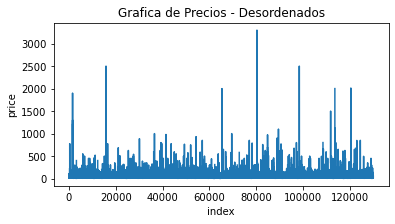

In [18]:
plt.figure(figsize=(6,3))
plt.plot(df['price'])
plt.title('Grafica de Precios - Desordenados')
plt.xlabel('index')
plt.ylabel('price')
plt.show()

C:\Users\ccoronad\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


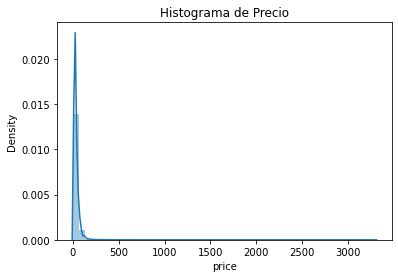

In [19]:
#Histograma de Precio
plt.figure(figsize=(6,4))
sns.distplot(df['price'])
plt.title('Histograma de Precio')
plt.show()

C:\Users\ccoronad\Anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


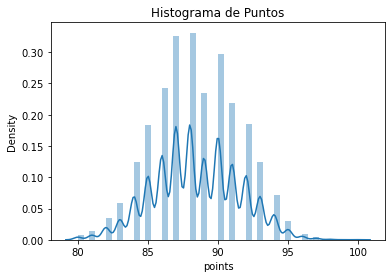

In [20]:
#Histograma de Puntos
plt.figure(figsize=(6,4))
sns.distplot(df['points'])
plt.title('Histograma de Puntos')
plt.show()

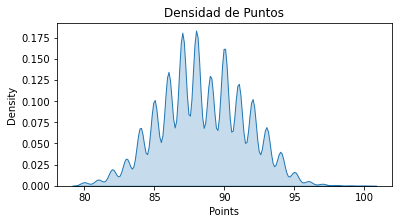

In [21]:
#Densidad de Puntos
plt.figure(figsize=(6,3))
sns.kdeplot(df['points'],shade=True)
plt.title('Densidad de Puntos')
plt.xlabel('Points');

C:\Users\ccoronad\Anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
C:\Users\ccoronad\Anaconda3\lib\site-packages\seaborn\_core.py:1326: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))


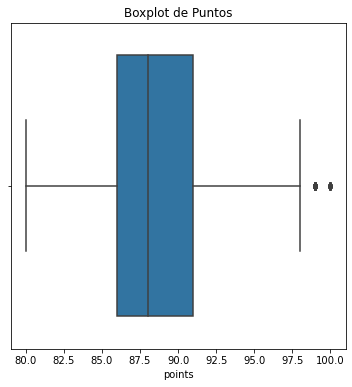

In [22]:
plt.figure(figsize=(6,6))
sns.boxplot(df['points'],orient='v')
plt.title('Boxplot de Puntos')
plt.show()

C:\Users\ccoronad\Anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
C:\Users\ccoronad\Anaconda3\lib\site-packages\seaborn\_core.py:1326: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))


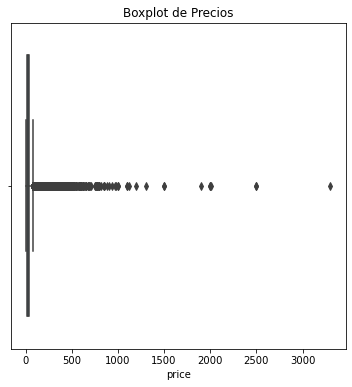

In [23]:
plt.figure(figsize=(6,6))
sns.boxplot(df['price'],orient='v')
plt.title('Boxplot de Precios')
plt.show()

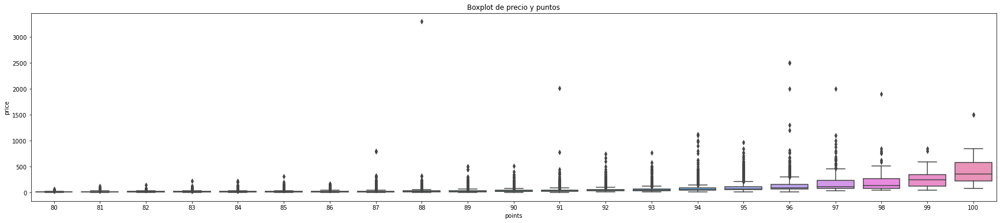

In [24]:
plt.figure(figsize=(30,6))
sns.boxplot(x='points',y='price',data=df)
plt.title('Boxplot de precio y puntos')
plt.show()

C:\Users\ccoronad\Anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


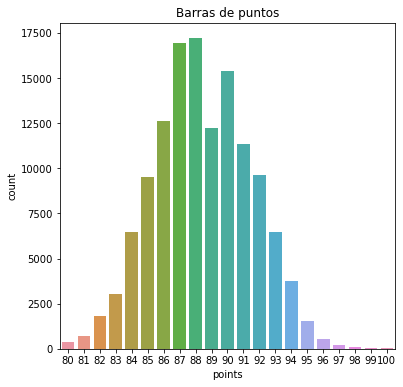

In [25]:
plt.figure(figsize=(6, 6))
sns.countplot('points',data=df)
plt.title('Barras de puntos')
plt.show()

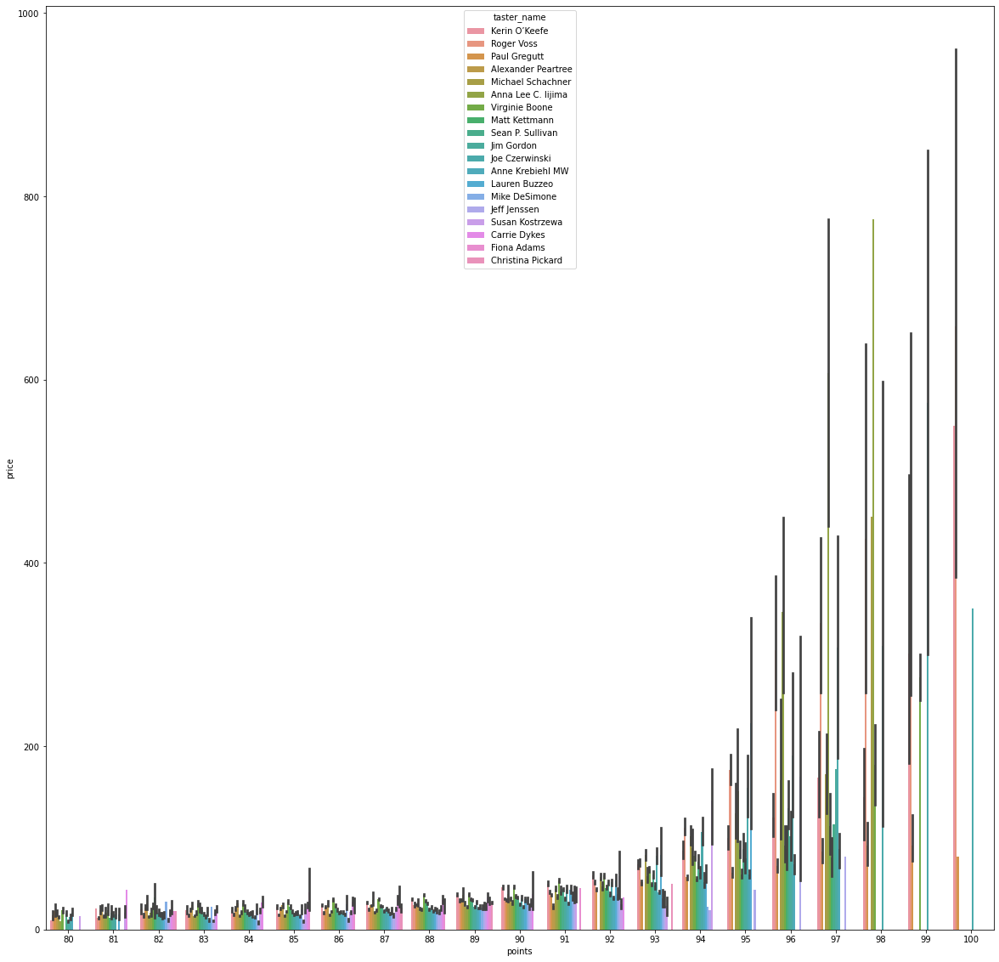

In [26]:
plt.figure(figsize=(20, 20))
sns.barplot(x='points',y='price',hue='taster_name',data=df)
plt.show()

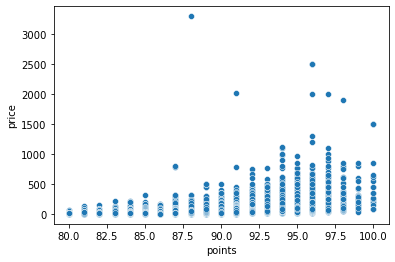

In [27]:
plt.figure()
sns.scatterplot(x='points', y='price', data=df)
plt.show()

In [28]:
!pip install plotly

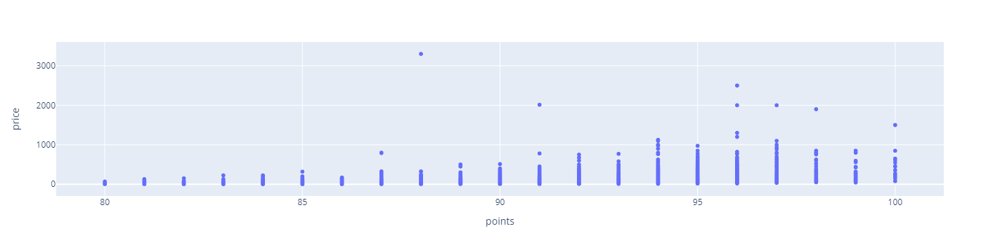

In [29]:
import plotly.express as px
fig = px.scatter(df,x='points',y='price')
fig.show()

In [30]:
df.corr()

,Unnamed: 0,points,price
Unnamed: 0,1.000000,0.007124,0.004823
points,0.007124,1.000000,0.416167
price,0.004823,0.416167,1.000000


En el análisis de la correlación, se encuentra que no existe una correlación entre el precio y el puntaje (así como también se puede ver en el scatter)

In [31]:
df.quantile([.1, .33, .5, .66, .9, .95, .99, .999, .9999], axis = 0)

,Unnamed: 0,points,price
0.1000,12997.000,85.0,12.000
0.3300,42890.100,87.0,20.000
0.5000,64985.000,88.0,25.000
0.6600,85780.200,90.0,35.000
0.9000,116973.000,92.0,65.000
0.9500,123471.500,93.0,85.000
0.9900,128670.300,95.0,155.000
0.9990,129840.030,97.0,468.026
0.9999,129957.003,100.0,1100.000


En el análisis de los quantiles (10%, 33%, 50%, 66%, 90%, 95%, 99%, 99.9% y 99.99%) se encuentra que la mayoría de los puntajes están por debajo de los 97 puntos y por debajo de los 500 USD en precio

# RegEx para sacar Años de los vinos

In [32]:
df['Year'] = df['title'].str.extract('([2][0][0-9][0-9])', expand=False).str.strip()
df['Year'] = df['Year'].fillna(0)
df['Year'] = df['Year'].astype(int)

In [33]:
df['Year'].unique()

array([2013, 2011, 2012, 2010, 2007, 2009, 2008, 2014, 2015,    0, 2016,
       2004, 2003, 2006, 2001, 2005, 2002, 2000, 2017])

# Temperatura

In [34]:
climate = pd.read_csv('temp.csv', delimiter=',')
climate.shape

(66880, 5)

In [35]:
climate.head()

,FID,id_punto,agno,temp_anual,geom
0,temp_anual_espacial_p.fid-6ba7a30a_177416e85c4...,0,2019,-14.87,POINT (-4202310.777446077 18546349.31878927)
1,temp_anual_espacial_p.fid-6ba7a30a_177416e85c4...,2,2019,-15.05,POINT (-4090991.2866528034 18546349.31878927)
2,temp_anual_espacial_p.fid-6ba7a30a_177416e85c4...,4,2019,-15.30,POINT (-3979671.7958595296 18546349.31878927)
3,temp_anual_espacial_p.fid-6ba7a30a_177416e85c4...,6,2019,-15.22,POINT (-3868352.305066257 18546349.31878927)
4,temp_anual_espacial_p.fid-6ba7a30a_177416e85c4...,7,2019,-15.24,POINT (-3812692.55966962 18546349.31878927)


In [36]:
climate.replace(regex=['POINT '], value='', inplace=True)
climate.replace(regex=['\('], value='', inplace=True)
climate.replace(regex=['\)'], value='', inplace=True)

In [37]:
climate.describe()

,id_punto,agno,temp_anual
count,66880.000000,66880.0,66880.000000
mean,33616.375329,2019.0,9.936966
std,19439.349213,0.0,14.484485
min,0.000000,2019.0,-23.250000
25%,16777.750000,2019.0,-2.470000
50%,33595.500000,2019.0,10.210000
75%,50401.250000,2019.0,24.360000
max,67419.000000,2019.0,54.300000


In [38]:
df2 = climate.geom.str.split(expand=True)
df2.head()

,0,1
0,-4202310.777446077,18546349.31878927
1,-4090991.2866528034,18546349.31878927
2,-3979671.7958595296,18546349.31878927
3,-3868352.305066257,18546349.31878927
4,-3812692.55966962,18546349.31878927


In [39]:
df2.dtypes

0    object
1    object
dtype: object

In [40]:
df2 = df2.rename(columns={0:'Latitude'})
df2 = df2.rename(columns={1:'Longitude'})
df2.head()

,Latitude,Longitude
0,-4202310.777446077,18546349.31878927
1,-4090991.2866528034,18546349.31878927
2,-3979671.7958595296,18546349.31878927
3,-3868352.305066257,18546349.31878927
4,-3812692.55966962,18546349.31878927


In [41]:
!pip install pyproj

In [42]:
from pyproj import Transformer
transformer = Transformer.from_crs("epsg:3857", "epsg:4326")
transformer.transform(12, 12)

(0.00010779783409427898, 0.00010779783409434257)

In [43]:
#import folium

In [44]:
#folium_map = folium.Map(location=[38.3, -122.3],
#                        zoom_start=8,
#                        tiles="OpenStreetMap")
#Now we can have a scatter plot of the first 1000 data points on the above map
#for i in range(0,1000):
#for i in range(0,66880):
#    x1,y1 = df2["Latitude"][i],df2["Longitude"][i]
#    x2,y2 = transformer.transform(x1, y1)
#    marker = folium.CircleMarker(location=[x2,y2],radius=5,color="blue",fill=True)
#    marker.add_to(folium_map)

#folium_map

In [45]:
df[df['region_2'].notnull()][['region_2','region_1']]

,region_2,region_1
2,Willamette Valley,Willamette Valley
4,Willamette Valley,Willamette Valley
10,Napa,Napa Valley
12,Sonoma,Alexander Valley
14,Central Coast,Central Coast
21,Oregon Other,Oregon
23,Central Coast,Paso Robles
25,Sonoma,Sonoma Coast
29,Central Valley,Clarksburg
33,Sonoma,Dry Creek Valley


In [46]:
df['region_2'].unique()

array([nan, 'Willamette Valley', 'Napa', 'Sonoma', 'Central Coast',
       'Oregon Other', 'Central Valley', 'North Coast', 'Columbia Valley',
       'California Other', 'Finger Lakes', 'Sierra Foothills',
       'New York Other', 'Long Island', 'Napa-Sonoma', 'Southern Oregon',
       'Washington Other', 'South Coast'], dtype=object)

In [47]:
df[df['region_1'].isnull()][['province','region_1']]

,province,region_1
1,Douro,NaN
8,Rheinhessen,NaN
15,Mosel,NaN
36,Colchagua Valley,NaN
44,Maule Valley,NaN
51,Colchagua Valley,NaN
58,Maipo Valley,NaN
76,Rheinhessen,NaN
79,Tejo,NaN
80,Rapel Valley,NaN
